<a href="https://colab.research.google.com/github/difyousra/AT-hackathon/blob/main/Copie_de_train_yolo11_object_detection_CARS__MOTORCYCLE_dataset.ipynb" target="_parent"><img src="https://colab.research.google.com/assets/colab-badge.svg" alt="Open In Colab"/></a>

In [1]:
!nvidia-smi

Thu Dec 19 22:41:58 2024       
+---------------------------------------------------------------------------------------+
| NVIDIA-SMI 535.104.05             Driver Version: 535.104.05   CUDA Version: 12.2     |
|-----------------------------------------+----------------------+----------------------+
| GPU  Name                 Persistence-M | Bus-Id        Disp.A | Volatile Uncorr. ECC |
| Fan  Temp   Perf          Pwr:Usage/Cap |         Memory-Usage | GPU-Util  Compute M. |
|                                         |                      |               MIG M. |
|=========================================+======================+======================|
|   0  Tesla T4                       Off | 00000000:00:04.0 Off |                    0 |
| N/A   43C    P8               9W /  70W |      0MiB / 15360MiB |      0%      Default |
|                                         |                      |                  N/A |
+-----------------------------------------+----------------------+--

**NOTE:** To make it easier for us to manage datasets, images and models we create a `HOME` constant.

In [2]:
import os
HOME = os.getcwd()
print(HOME)

/content


## Install YOLO11 via Ultralytics

In [3]:
%pip install "ultralytics<=8.3.40" supervision roboflow
import ultralytics
ultralytics.checks()

Ultralytics 8.3.40 🚀 Python-3.10.12 torch-2.5.1+cu121 CUDA:0 (Tesla T4, 15102MiB)
Setup complete ✅ (8 CPUs, 51.0 GB RAM, 32.7/235.7 GB disk)


## Inference with model pre-trained on COCO dataset

### CLI

**NOTE:** CLI requires no customization or Python code. You can simply run all tasks from the terminal with the yolo command.

**NOTE:** Result annotated image got saved in `{HOME}/runs/detect/predict/`. Let's display it.

### SDK

**NOTE:** YOLO's Python interface allows for seamless integration into your Python projects, making it easy to load, run, and process the model's output.

**NOTE:** YOLO11 can be easily integrated with `supervision` using the familiar `from_ultralytics` connector.

## Fine-tune YOLO11 on custom dataset

**NOTE:** When training YOLOv11, make sure your data is located in `datasets`. If you'd like to change the default location of the data you want to use for fine-tuning, you can do so through Ultralytics' `settings.json`. In this tutorial, we will use one of the [datasets](https://universe.roboflow.com/liangdianzhong/-qvdww) available on [Roboflow Universe](https://universe.roboflow.com/). When downloading, make sure to select the `yolov11` export format.

## Custom Training

In [5]:
!pip install roboflow

from roboflow import Roboflow
rf = Roboflow(api_key="x9aUpUz0AjutiXuaeQBa")
project = rf.workspace("at-hackaton").project("at-hackathon")
version = project.version(1)
dataset = version.download("yolov11")


loading Roboflow workspace...
loading Roboflow project...



Extracting Dataset Version Zip to AT-HACKATHON-1 in yolov11:: 100%|██████████| 4699/4699 [00:00<00:00, 6918.36it/s]


In [6]:


!yolo task=detect mode=train model=yolo11s.pt data=/content/MATRICULE-1/data.yaml epochs=60 imgsz=640 plots=True

100% 18.4M/18.4M [00:00<00:00, 35.7MB/s]
New https://pypi.org/project/ultralytics/8.3.51 available 😃 Update with 'pip install -U ultralytics'
Ultralytics 8.3.40 🚀 Python-3.10.12 torch-2.5.1+cu121 CUDA:0 (Tesla T4, 15102MiB)
engine/trainer: task=detect, mode=train, model=yolo11s.pt, data=/content/MATRICULE-1/data.yaml, epochs=60, time=None, patience=100, batch=16, imgsz=640, save=True, save_period=-1, cache=False, device=None, workers=8, project=None, name=train, exist_ok=False, pretrained=True, optimizer=auto, verbose=True, seed=0, deterministic=True, single_cls=False, rect=False, cos_lr=False, close_mosaic=10, resume=False, amp=True, fraction=1.0, profile=False, freeze=None, multi_scale=False, overlap_mask=True, mask_ratio=4, dropout=0.0, val=True, split=val, save_json=False, save_hybrid=False, conf=None, iou=0.7, max_det=300, half=False, dnn=False, plots=True, source=None, vid_stride=1, stream_buffer=False, visualize=False, augment=False, agnostic_nms=False, classes=None, retina_mask

In [ ]:
!yolo task=detect mode=train model=/content/runs/detect/train/weights/last.pt data=/content/MATRICULE-1/data.yaml epochs=40 imgsz=640 plots=True

New https://pypi.org/project/ultralytics/8.3.49 available 😃 Update with 'pip install -U ultralytics'
Ultralytics 8.3.40 🚀 Python-3.10.12 torch-2.5.1+cu121 CUDA:0 (Tesla T4, 15102MiB)
engine/trainer: task=detect, mode=train, model=/content/runs/detect/train3/weights/last.pt, data=/content/accident-detection-10/data.yaml, epochs=40, time=None, patience=100, batch=16, imgsz=640, save=True, save_period=-1, cache=False, device=None, workers=8, project=None, name=train4, exist_ok=False, pretrained=True, optimizer=auto, verbose=True, seed=0, deterministic=True, single_cls=False, rect=False, cos_lr=False, close_mosaic=10, resume=False, amp=True, fraction=1.0, profile=False, freeze=None, multi_scale=False, overlap_mask=True, mask_ratio=4, dropout=0.0, val=True, split=val, save_json=False, save_hybrid=False, conf=None, iou=0.7, max_det=300, half=False, dnn=False, plots=True, source=None, vid_stride=1, stream_buffer=False, visualize=False, augment=False, agnostic_nms=False, classes=None, retina_m

**NOTE:** The results of the completed training are saved in `{HOME}/runs/detect/train/`. Let's examine them.

In [7]:
!ls {HOME}/runs/detect/train/

args.yaml					     R_curve.png	  val_batch0_labels.jpg
confusion_matrix_normalized.png			     results.csv	  val_batch0_pred.jpg
confusion_matrix.png				     results.png	  val_batch1_labels.jpg
events.out.tfevents.1734654541.68e92a488c27.28334.0  train_batch0.jpg	  val_batch1_pred.jpg
F1_curve.png					     train_batch1.jpg	  val_batch2_labels.jpg
labels_correlogram.jpg				     train_batch2.jpg	  val_batch2_pred.jpg
labels.jpg					     train_batch5850.jpg  weights
P_curve.png					     train_batch5851.jpg
PR_curve.png					     train_batch5852.jpg


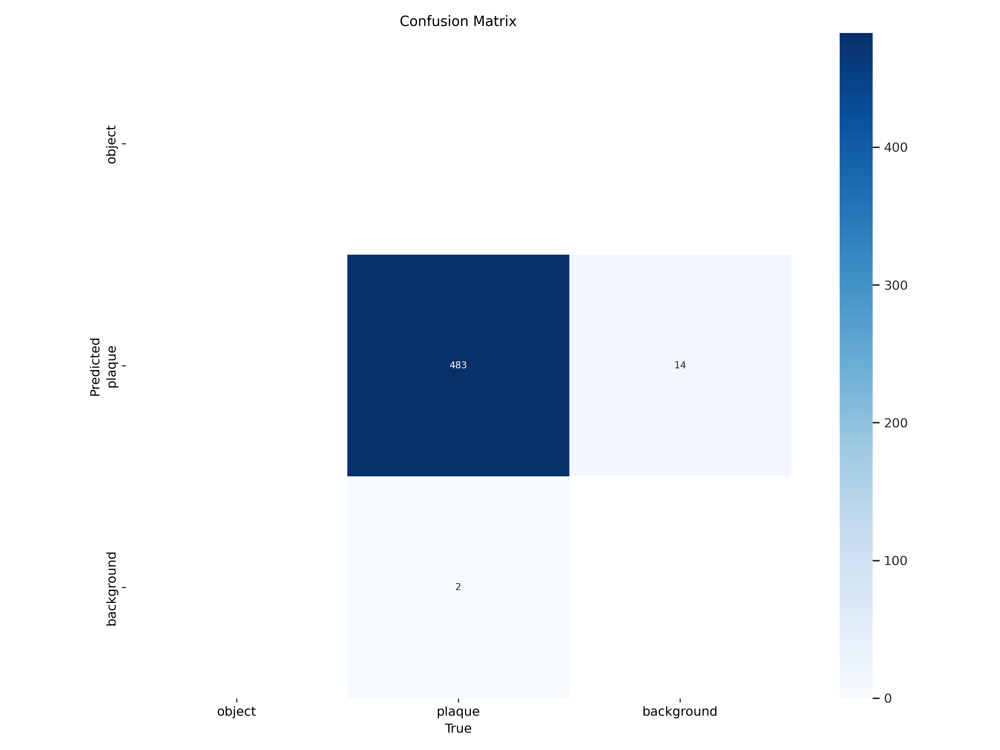

In [8]:
from IPython.display import Image as IPyImage

IPyImage(filename=f'{HOME}/runs/detect/train/confusion_matrix.png', width=600)

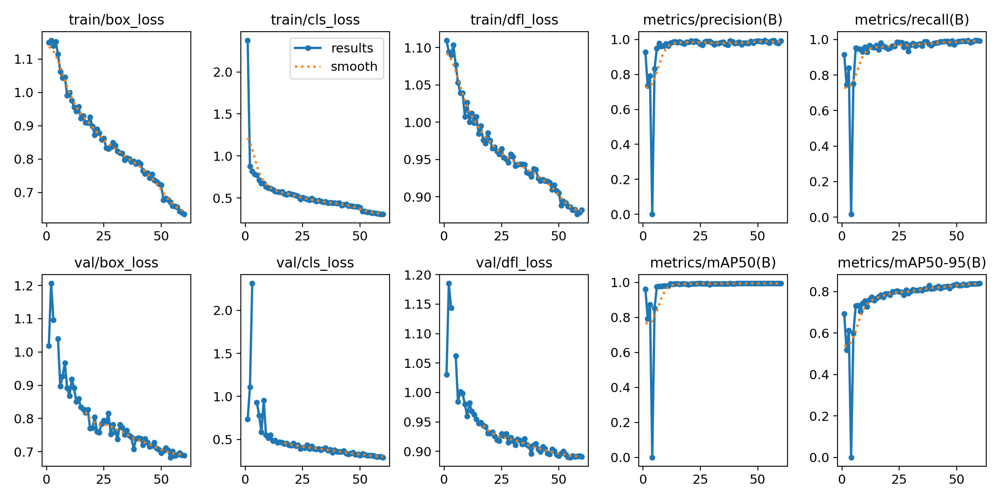

In [9]:
from IPython.display import Image as IPyImage

IPyImage(filename=f'{HOME}/runs/detect/train/results.png', width=600)

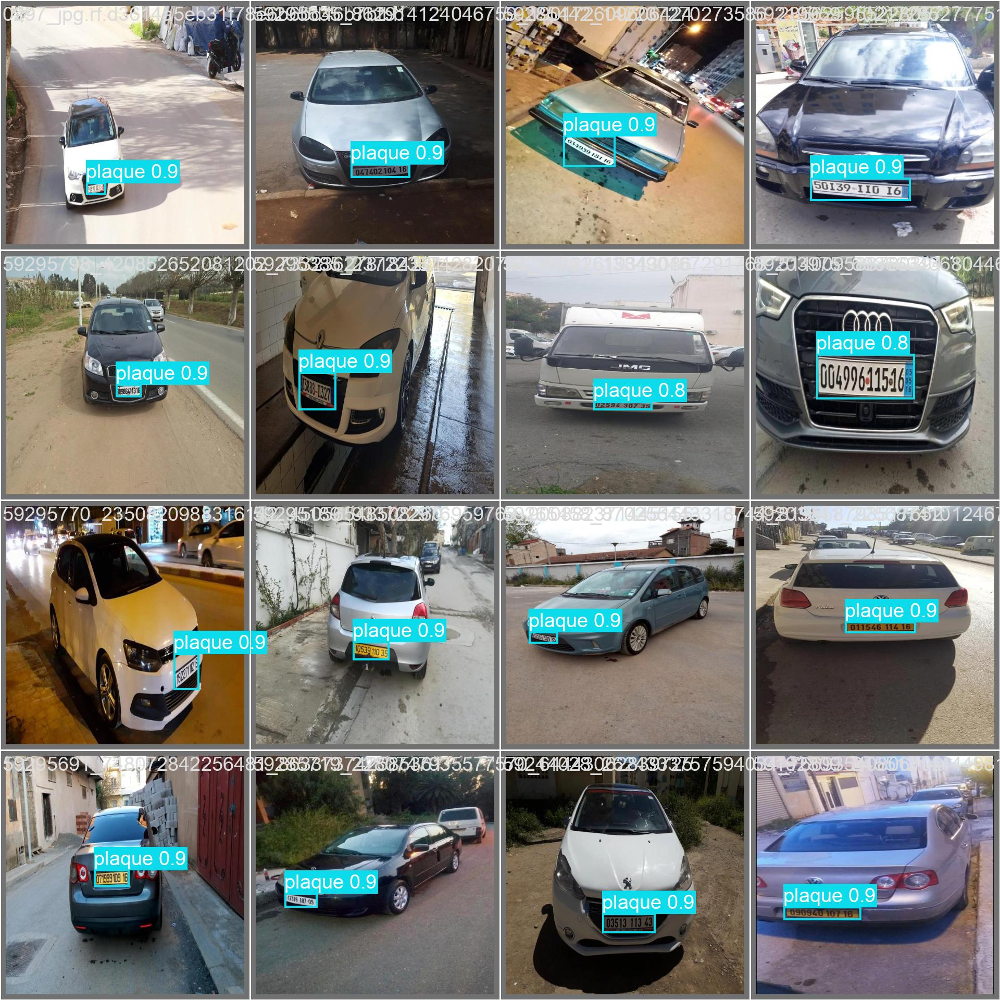

In [10]:
from IPython.display import Image as IPyImage

IPyImage(filename=f'{HOME}/runs/detect/train/val_batch0_pred.jpg', width=600)

## Validate fine-tuned model

In [11]:
!yolo task=detect mode=val model={HOME}/runs/detect/train/weights/best.pt data={dataset.location}/data.yaml

Ultralytics 8.3.40 🚀 Python-3.10.12 torch-2.5.1+cu121 CUDA:0 (Tesla T4, 15102MiB)
YOLO11s summary (fused): 238 layers, 9,413,574 parameters, 0 gradients, 21.3 GFLOPs
val: Scanning /content/AT-HACKATHON-1/valid/labels... 473 images, 0 backgrounds, 0 corrupt: 100% 473/473 [00:00<00:00, 1257.90it/s]
val: New cache created: /content/AT-HACKATHON-1/valid/labels.cache
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100% 30/30 [00:06<00:00,  4.59it/s]
                   all        473        485      0.992      0.993      0.995      0.841
                plaque        473        485      0.992      0.993      0.995      0.841
Speed: 0.6ms preprocess, 8.4ms inference, 0.0ms loss, 2.1ms postprocess per image
Results saved to runs/detect/val
💡 Learn more at https://docs.ultralytics.com/modes/val


## Inference with custom model

In [18]:
# Mount Google Drive
from google.colab import drive
drive.mount('/content/drive')

# Import required libraries
import shutil
import os

# Paths
source_path = "/content/runs/detect/train/weights/best.pt"
destination_path = "/content/drive/MyDrive/YOLOv11Models/best.pt"

# Ensure destination directory exists
os.makedirs(os.path.dirname(destination_path), exist_ok=True)

# Copy the model file
shutil.copy(source_path, destination_path)

print(f"Model saved to: {destination_path}")

# Verify saved file
!ls /content/drive/MyDrive/YOLOv11Models/


Drive already mounted at /content/drive; to attempt to forcibly remount, call drive.mount("/content/drive", force_remount=True).
Model saved to: /content/drive/MyDrive/YOLOv11Models/best.pt
best.pt


**inference**

In [19]:
# Cellule 1: Installation des Bibliothèques Nécessaires
!pip install ultralytics supervision easyocr filterpy scipy pillow  opencv-python-headless



     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 178.0/178.0 kB 3.1 MB/s eta 0:00:00
  Preparing metadata (setup.py) ... done
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 2.9/2.9 MB 43.5 MB/s eta 0:00:00
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 422.9/422.9 kB 36.1 MB/s eta 0:00:00
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 912.2/912.2 kB 56.9 MB/s eta 0:00:00
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 286.8/286.8 kB 29.0 MB/s eta 0:00:00
  Created wheel for filterpy: filename=filterpy-1.4.5-py3-none-any.whl size=110458 sha256=858c7a1a00fee8890139bc4d98b3a5b3ec4f3fd1ee0245c0ce41e84868a04279
  Stored in directory: /root/.cache/pip/wheels/0f/0c/ea/218f266af4ad626897562199fbbcba521b8497303200186102
Successfully built filterpy


Nombre total de frames : 631
FPS : 30
Frames à traiter : 30

0: 416x640 2 cars, 14.5ms
Speed: 2.3ms preprocess, 14.5ms inference, 1.4ms postprocess per image at shape (1, 3, 416, 640)

0: 416x640 1 plaque, 12.6ms
Speed: 2.0ms preprocess, 12.6ms inference, 1.2ms postprocess per image at shape (1, 3, 416, 640)


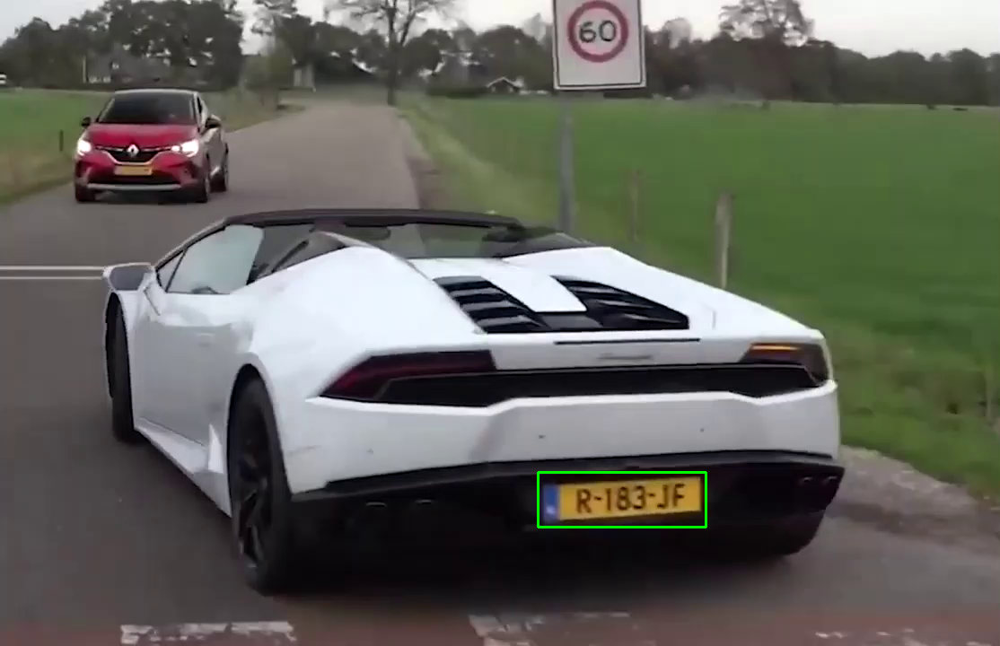


0: 416x640 2 cars, 12.8ms
Speed: 2.2ms preprocess, 12.8ms inference, 1.7ms postprocess per image at shape (1, 3, 416, 640)

0: 416x640 1 plaque, 11.9ms
Speed: 2.9ms preprocess, 11.9ms inference, 1.3ms postprocess per image at shape (1, 3, 416, 640)


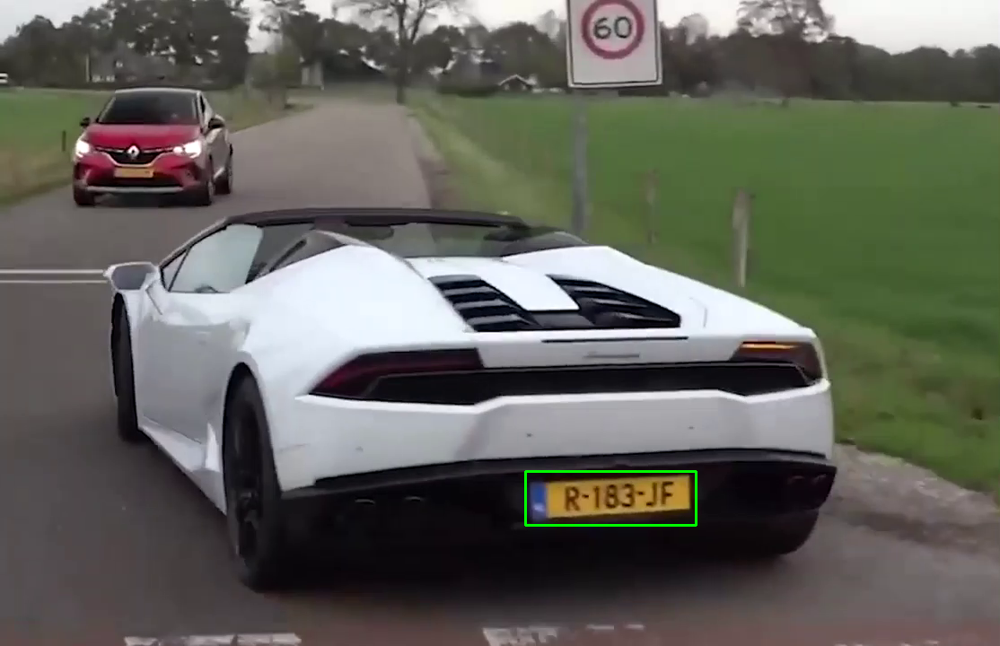


0: 416x640 2 cars, 12.9ms
Speed: 3.3ms preprocess, 12.9ms inference, 1.3ms postprocess per image at shape (1, 3, 416, 640)

0: 416x640 1 plaque, 11.9ms
Speed: 2.2ms preprocess, 11.9ms inference, 1.2ms postprocess per image at shape (1, 3, 416, 640)


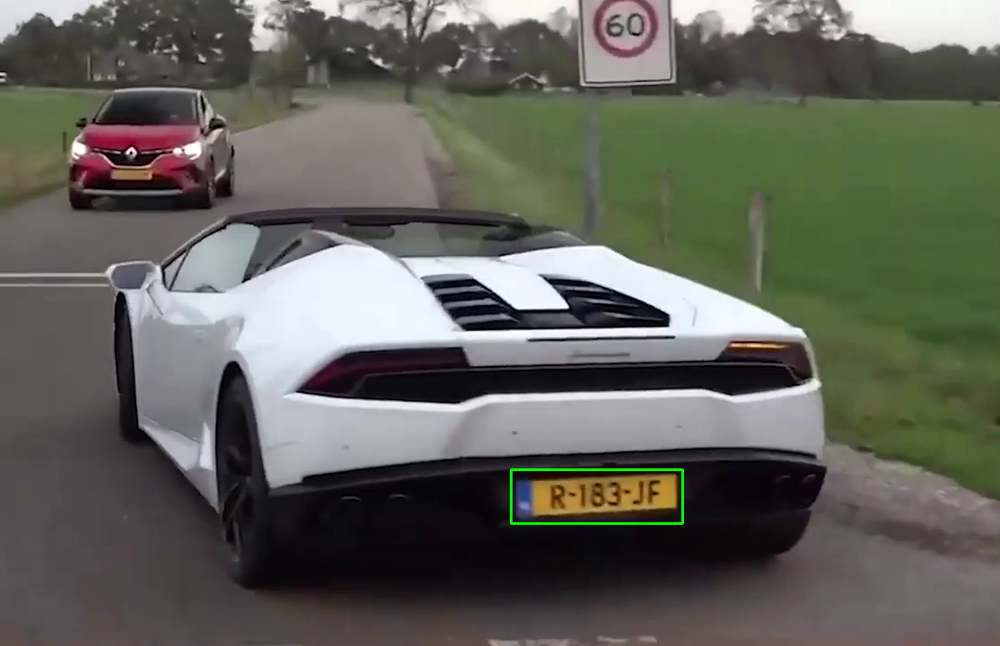


0: 416x640 2 cars, 12.9ms
Speed: 2.2ms preprocess, 12.9ms inference, 1.3ms postprocess per image at shape (1, 3, 416, 640)

0: 416x640 1 plaque, 11.9ms
Speed: 2.0ms preprocess, 11.9ms inference, 1.3ms postprocess per image at shape (1, 3, 416, 640)


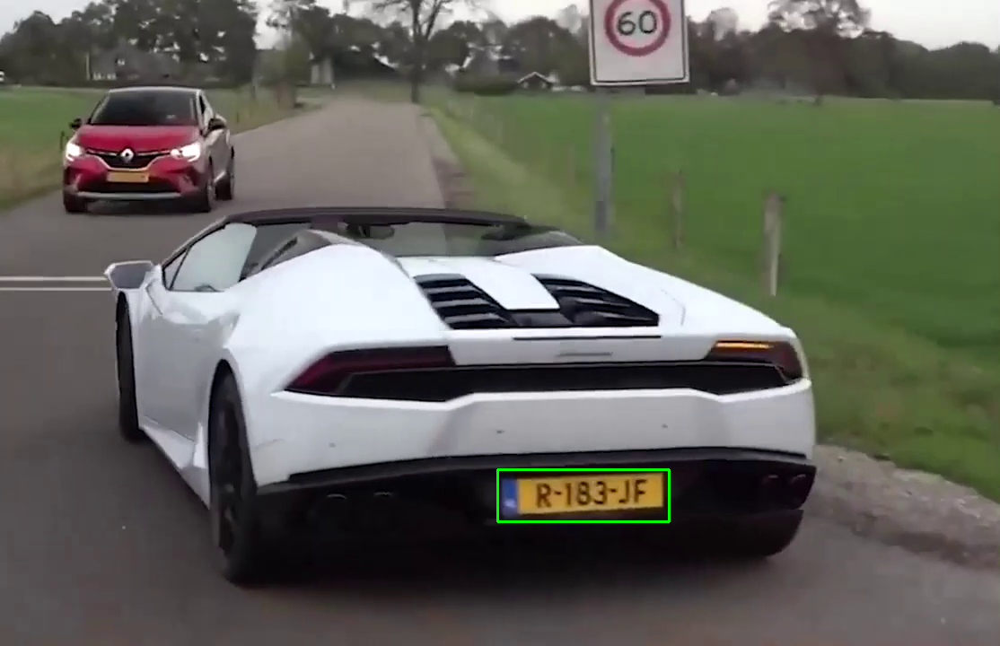


0: 416x640 2 cars, 12.9ms
Speed: 2.4ms preprocess, 12.9ms inference, 1.4ms postprocess per image at shape (1, 3, 416, 640)

0: 416x640 1 plaque, 11.9ms
Speed: 3.1ms preprocess, 11.9ms inference, 1.1ms postprocess per image at shape (1, 3, 416, 640)


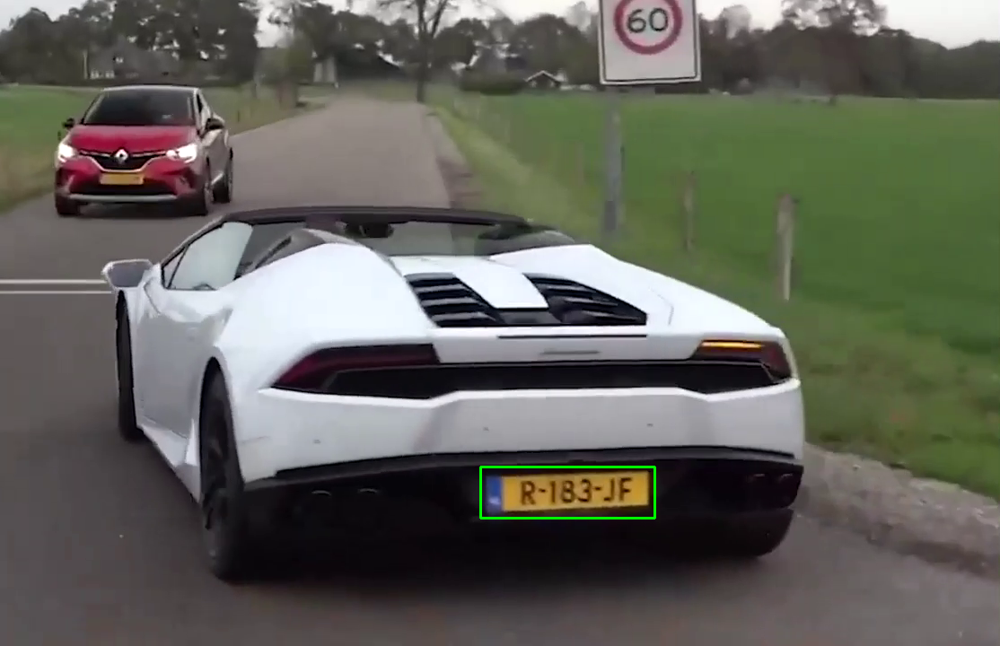


0: 416x640 2 cars, 12.9ms
Speed: 2.2ms preprocess, 12.9ms inference, 1.6ms postprocess per image at shape (1, 3, 416, 640)

0: 416x640 1 plaque, 11.9ms
Speed: 3.2ms preprocess, 11.9ms inference, 1.4ms postprocess per image at shape (1, 3, 416, 640)


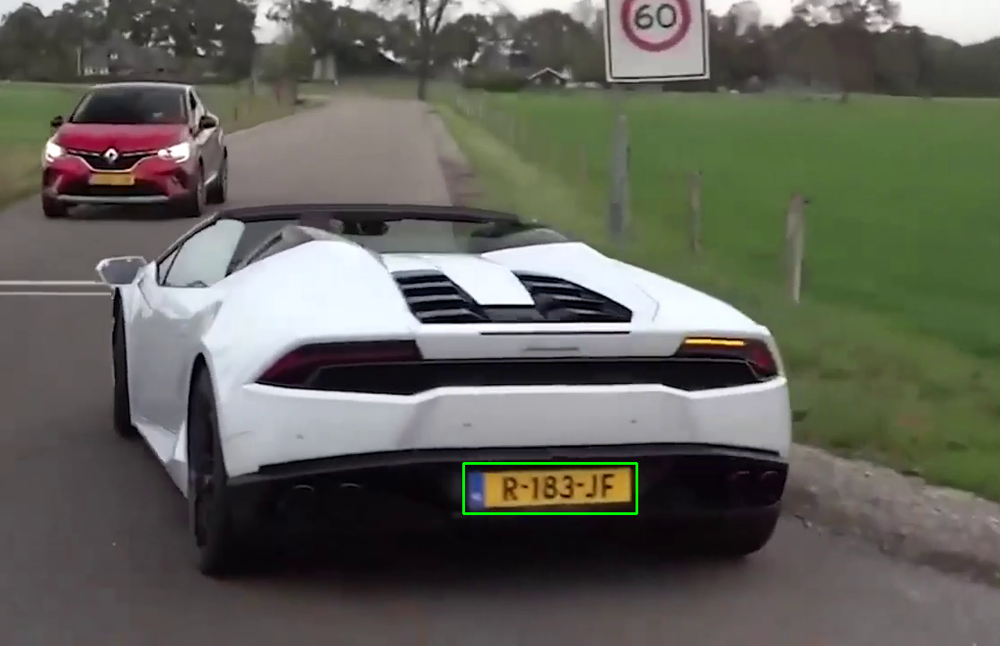


0: 416x640 2 cars, 12.9ms
Speed: 3.3ms preprocess, 12.9ms inference, 1.7ms postprocess per image at shape (1, 3, 416, 640)

0: 416x640 1 plaque, 11.9ms
Speed: 2.4ms preprocess, 11.9ms inference, 1.4ms postprocess per image at shape (1, 3, 416, 640)


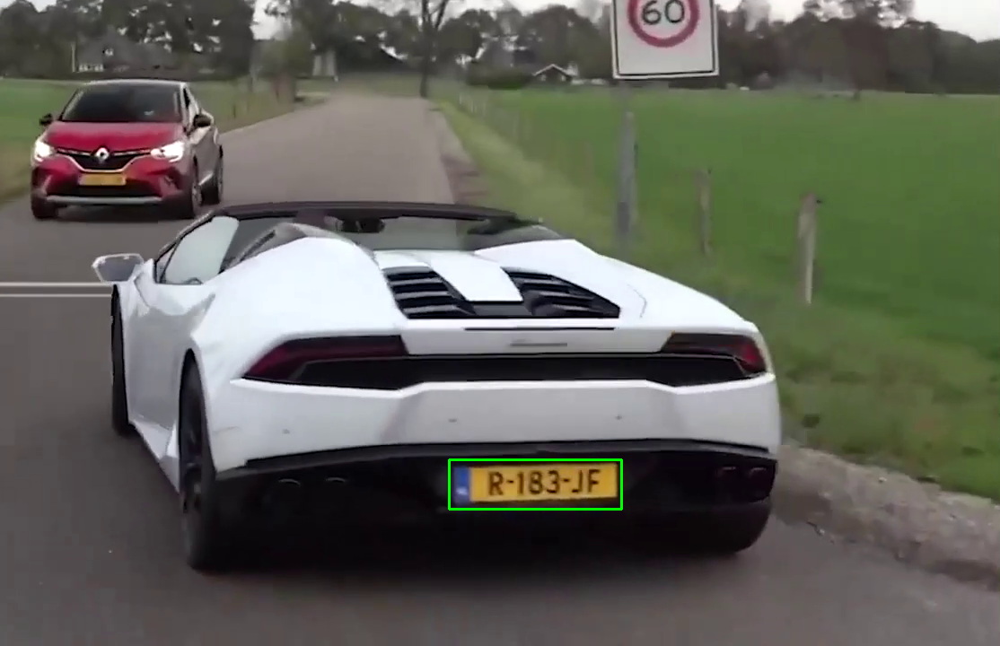


0: 416x640 2 cars, 12.9ms
Speed: 2.4ms preprocess, 12.9ms inference, 1.4ms postprocess per image at shape (1, 3, 416, 640)

0: 416x640 1 plaque, 11.9ms
Speed: 2.1ms preprocess, 11.9ms inference, 1.2ms postprocess per image at shape (1, 3, 416, 640)


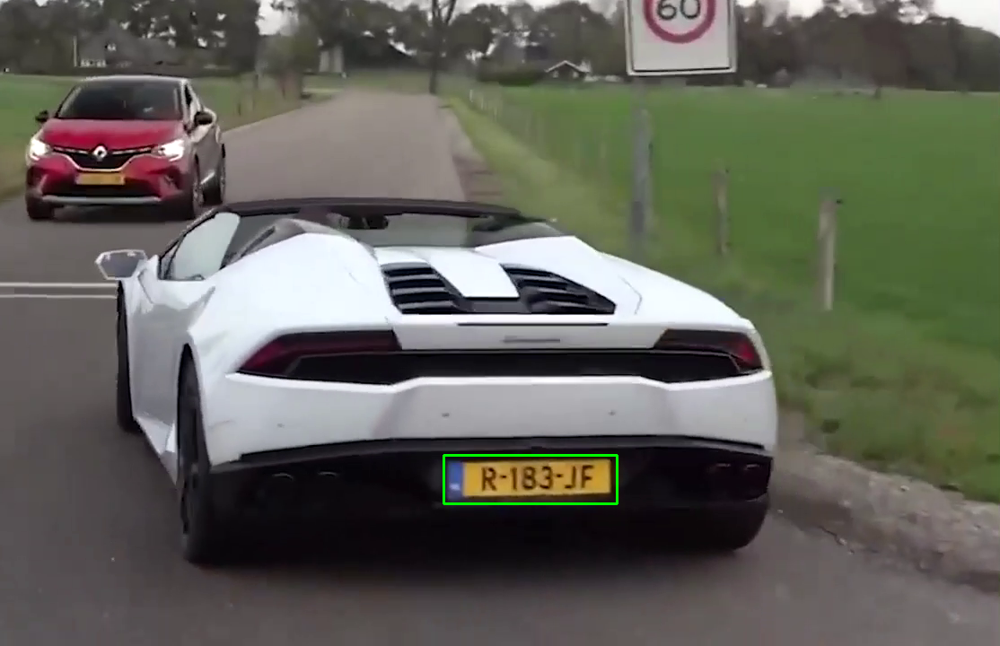


0: 416x640 2 cars, 12.9ms
Speed: 2.1ms preprocess, 12.9ms inference, 1.4ms postprocess per image at shape (1, 3, 416, 640)

0: 416x640 1 plaque, 11.9ms
Speed: 2.0ms preprocess, 11.9ms inference, 1.2ms postprocess per image at shape (1, 3, 416, 640)


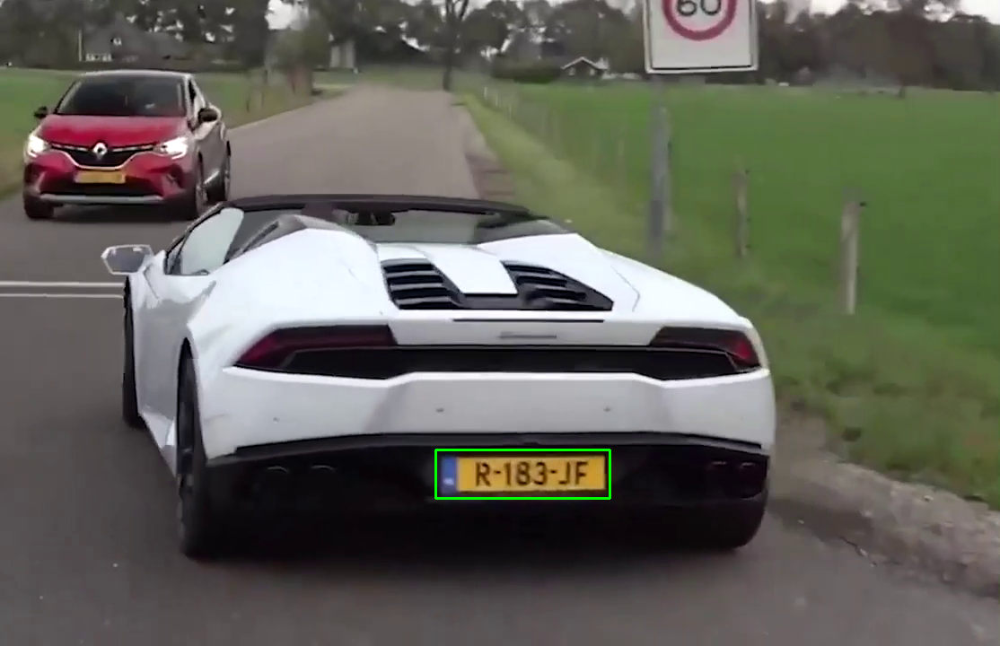


0: 416x640 2 cars, 12.9ms
Speed: 2.0ms preprocess, 12.9ms inference, 1.4ms postprocess per image at shape (1, 3, 416, 640)

0: 416x640 1 plaque, 11.9ms
Speed: 2.1ms preprocess, 11.9ms inference, 1.1ms postprocess per image at shape (1, 3, 416, 640)


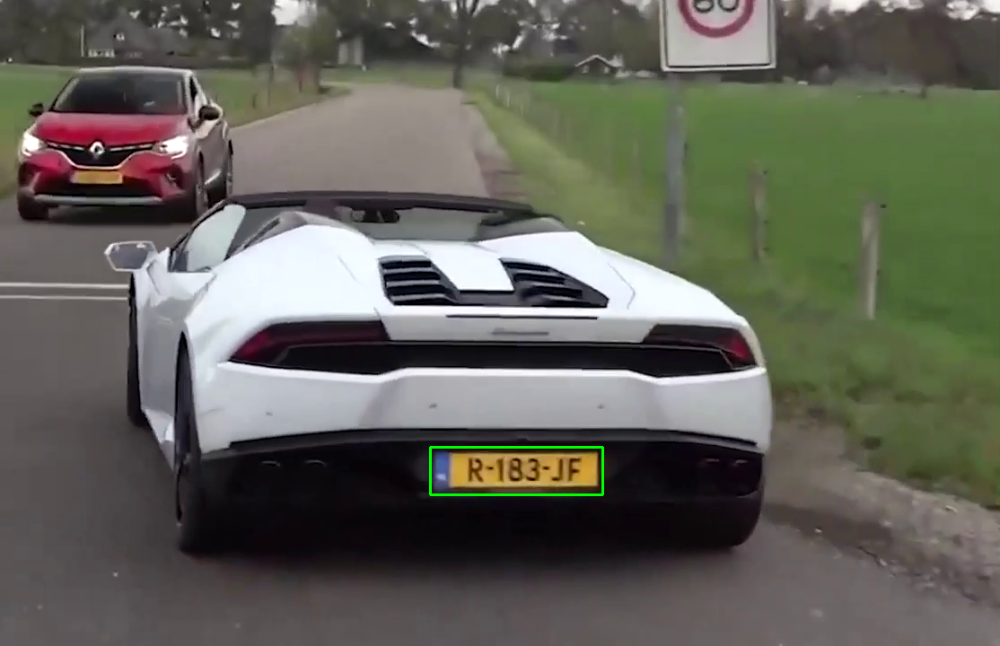


0: 416x640 2 cars, 12.9ms
Speed: 2.4ms preprocess, 12.9ms inference, 1.6ms postprocess per image at shape (1, 3, 416, 640)

0: 416x640 1 plaque, 11.9ms
Speed: 2.0ms preprocess, 11.9ms inference, 1.2ms postprocess per image at shape (1, 3, 416, 640)


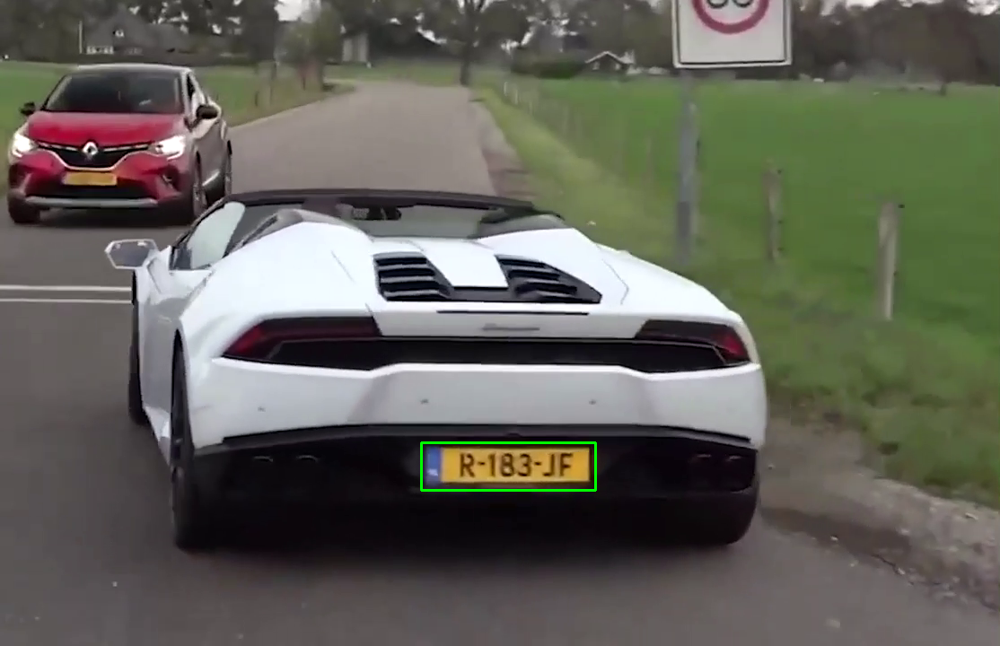


0: 416x640 2 cars, 12.9ms
Speed: 3.0ms preprocess, 12.9ms inference, 1.6ms postprocess per image at shape (1, 3, 416, 640)

0: 416x640 1 plaque, 11.9ms
Speed: 2.5ms preprocess, 11.9ms inference, 1.2ms postprocess per image at shape (1, 3, 416, 640)


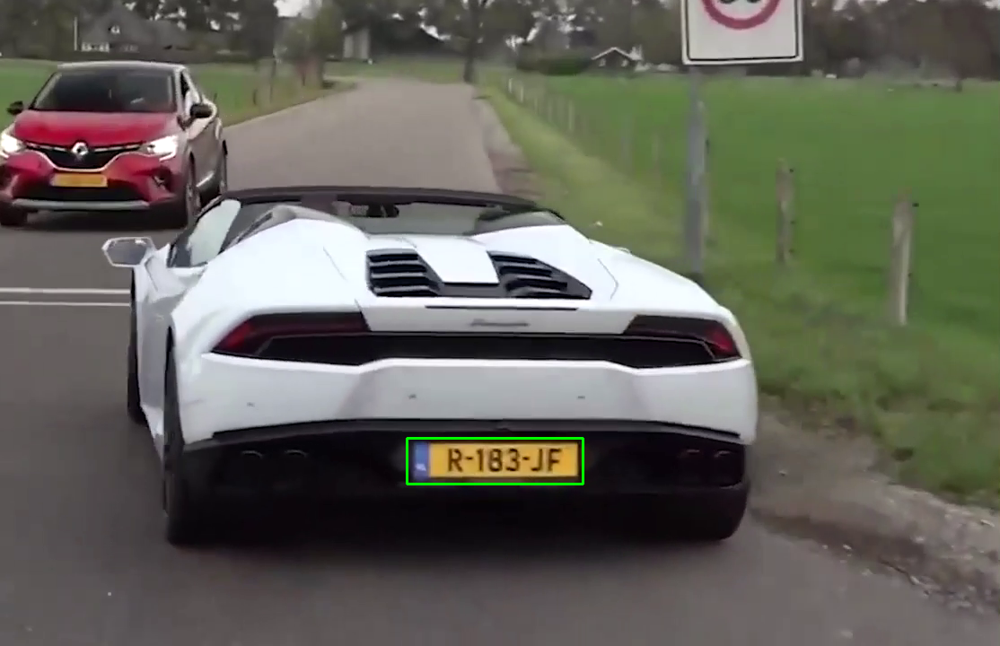


0: 416x640 3 cars, 12.9ms
Speed: 2.3ms preprocess, 12.9ms inference, 1.3ms postprocess per image at shape (1, 3, 416, 640)

0: 416x640 1 plaque, 11.9ms
Speed: 2.2ms preprocess, 11.9ms inference, 1.2ms postprocess per image at shape (1, 3, 416, 640)


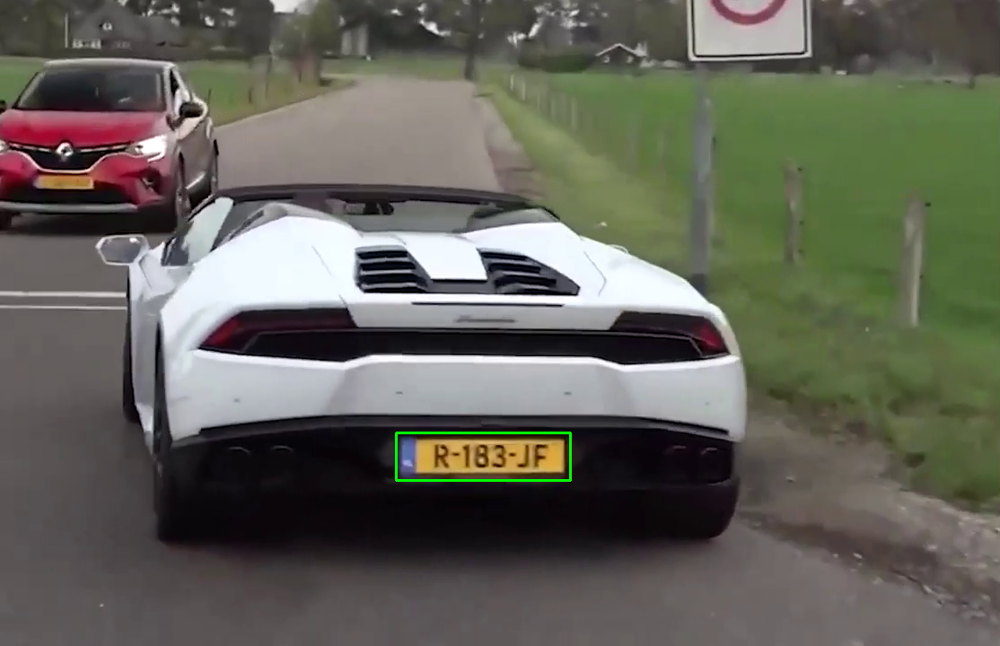


0: 416x640 2 cars, 12.9ms
Speed: 3.5ms preprocess, 12.9ms inference, 1.5ms postprocess per image at shape (1, 3, 416, 640)

0: 416x640 1 plaque, 12.7ms
Speed: 2.4ms preprocess, 12.7ms inference, 1.5ms postprocess per image at shape (1, 3, 416, 640)


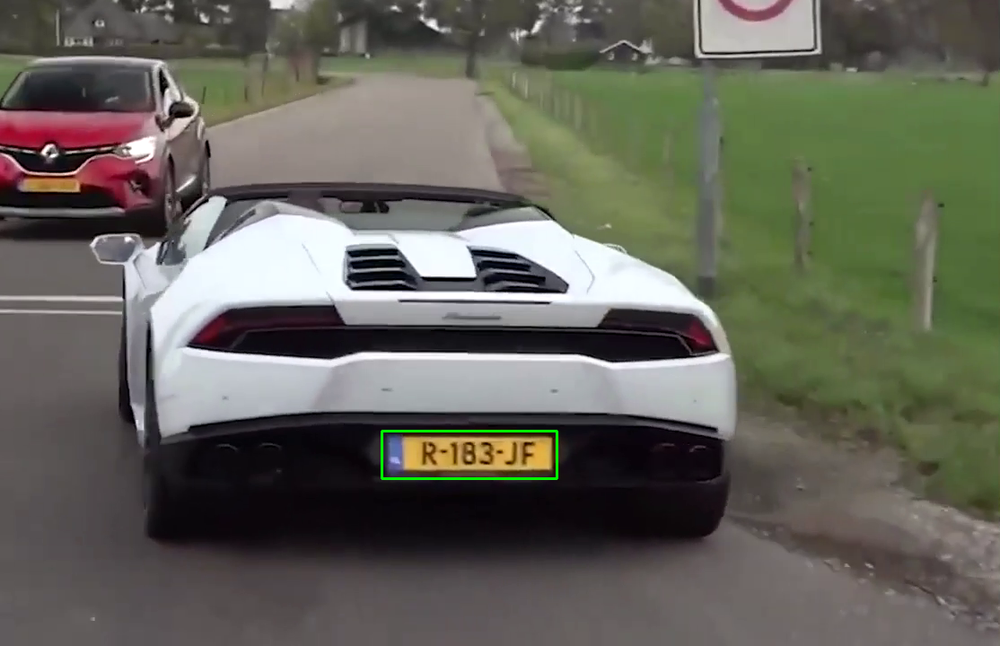


0: 416x640 2 cars, 12.9ms
Speed: 2.2ms preprocess, 12.9ms inference, 1.4ms postprocess per image at shape (1, 3, 416, 640)

0: 416x640 1 plaque, 11.9ms
Speed: 2.2ms preprocess, 11.9ms inference, 1.2ms postprocess per image at shape (1, 3, 416, 640)


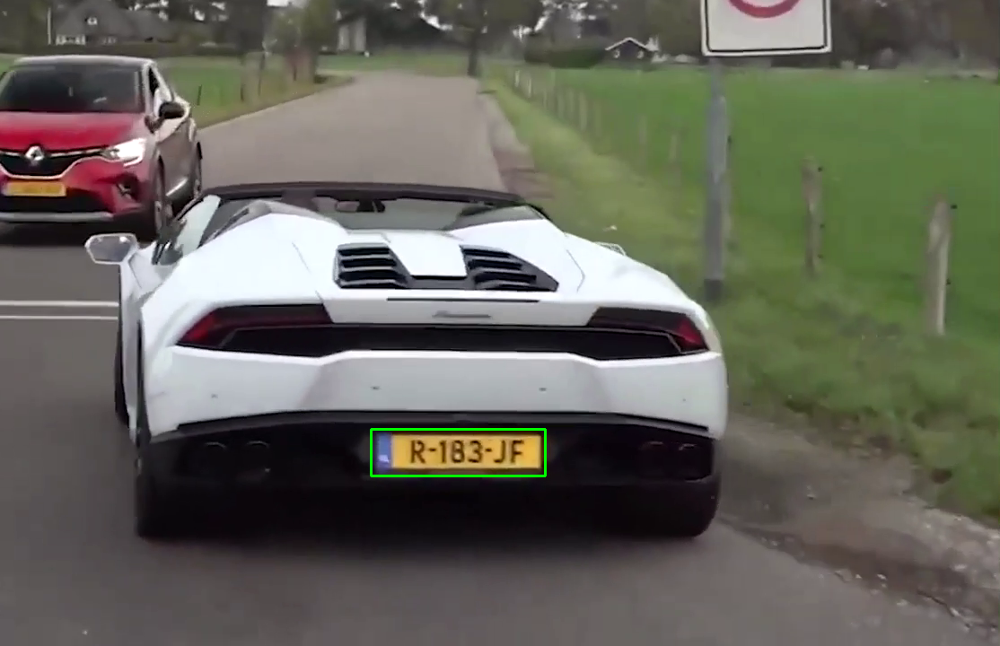


0: 416x640 2 cars, 12.9ms
Speed: 2.4ms preprocess, 12.9ms inference, 1.3ms postprocess per image at shape (1, 3, 416, 640)

0: 416x640 1 plaque, 11.9ms
Speed: 3.2ms preprocess, 11.9ms inference, 1.4ms postprocess per image at shape (1, 3, 416, 640)


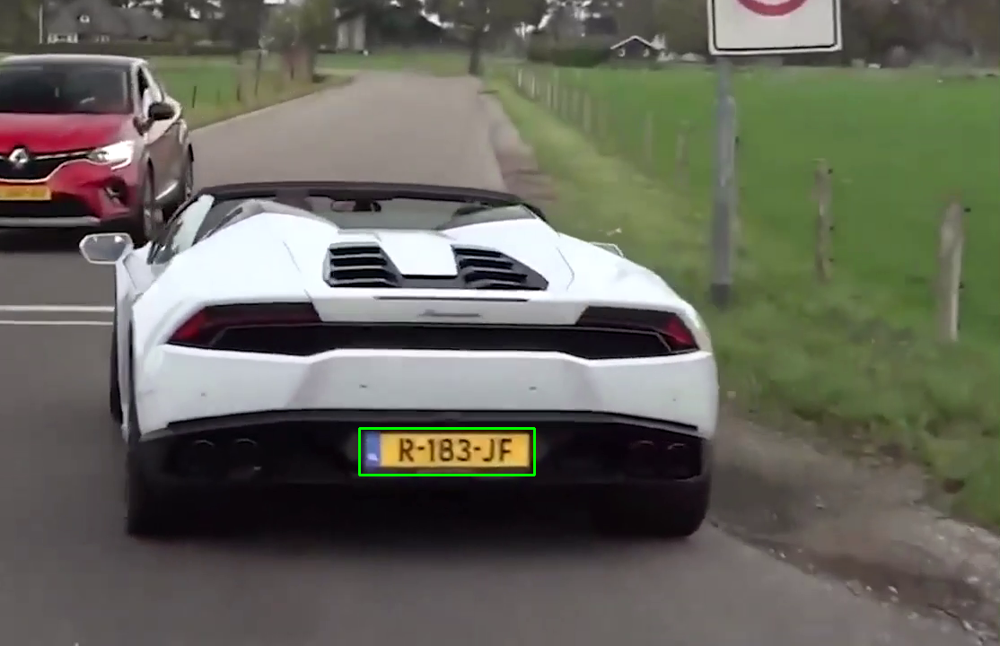


0: 416x640 2 cars, 12.9ms
Speed: 2.3ms preprocess, 12.9ms inference, 1.3ms postprocess per image at shape (1, 3, 416, 640)

0: 416x640 1 plaque, 11.9ms
Speed: 2.0ms preprocess, 11.9ms inference, 1.1ms postprocess per image at shape (1, 3, 416, 640)


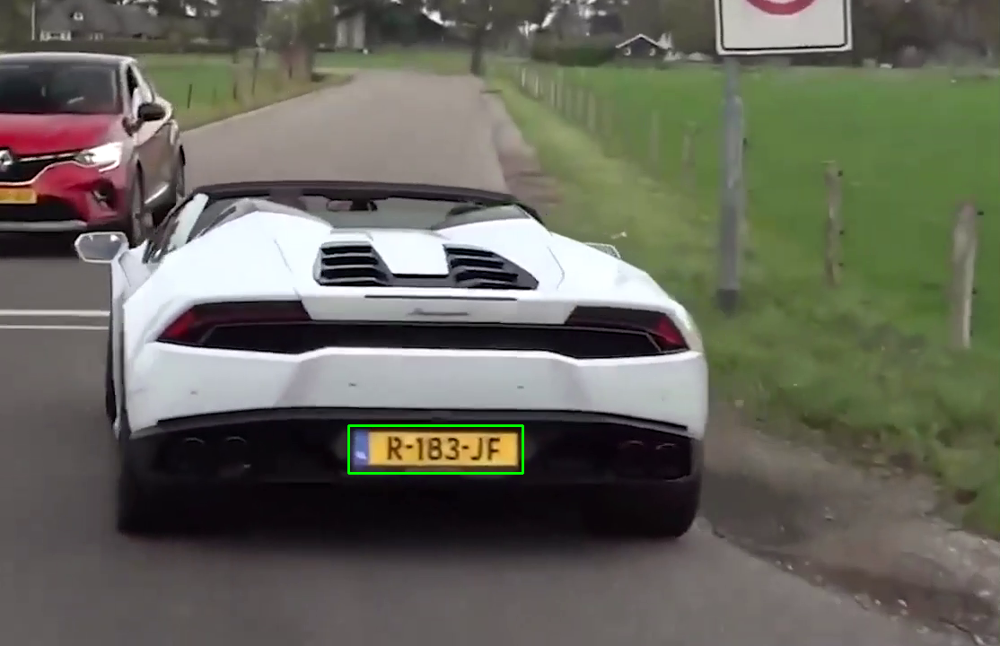


0: 416x640 2 cars, 12.9ms
Speed: 2.0ms preprocess, 12.9ms inference, 1.3ms postprocess per image at shape (1, 3, 416, 640)

0: 416x640 1 plaque, 11.9ms
Speed: 3.1ms preprocess, 11.9ms inference, 1.2ms postprocess per image at shape (1, 3, 416, 640)


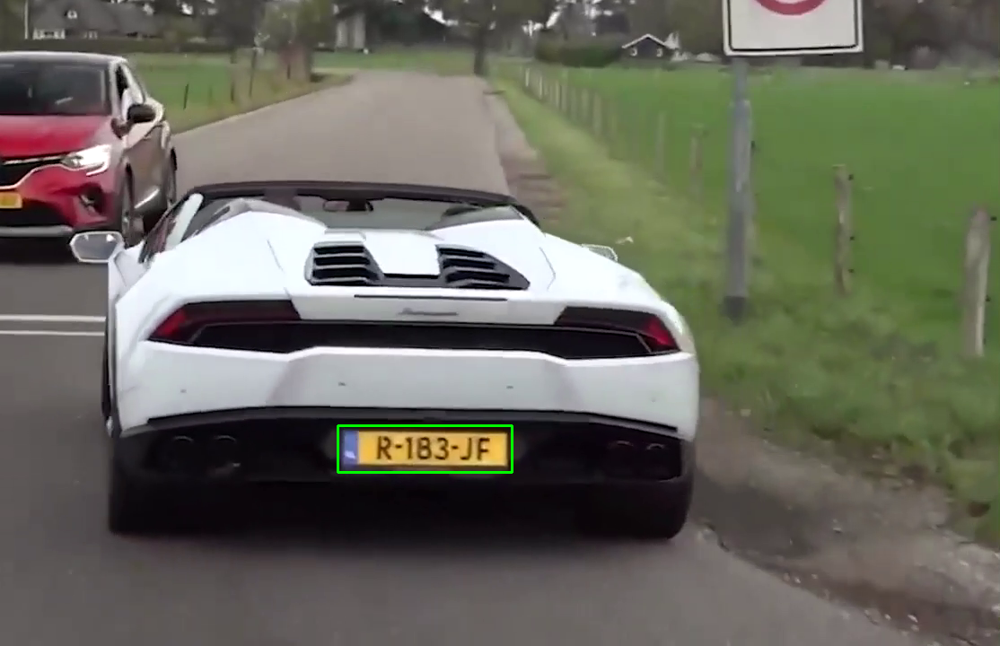


0: 416x640 2 cars, 12.9ms
Speed: 2.9ms preprocess, 12.9ms inference, 1.4ms postprocess per image at shape (1, 3, 416, 640)

0: 416x640 1 plaque, 11.9ms
Speed: 3.3ms preprocess, 11.9ms inference, 1.2ms postprocess per image at shape (1, 3, 416, 640)


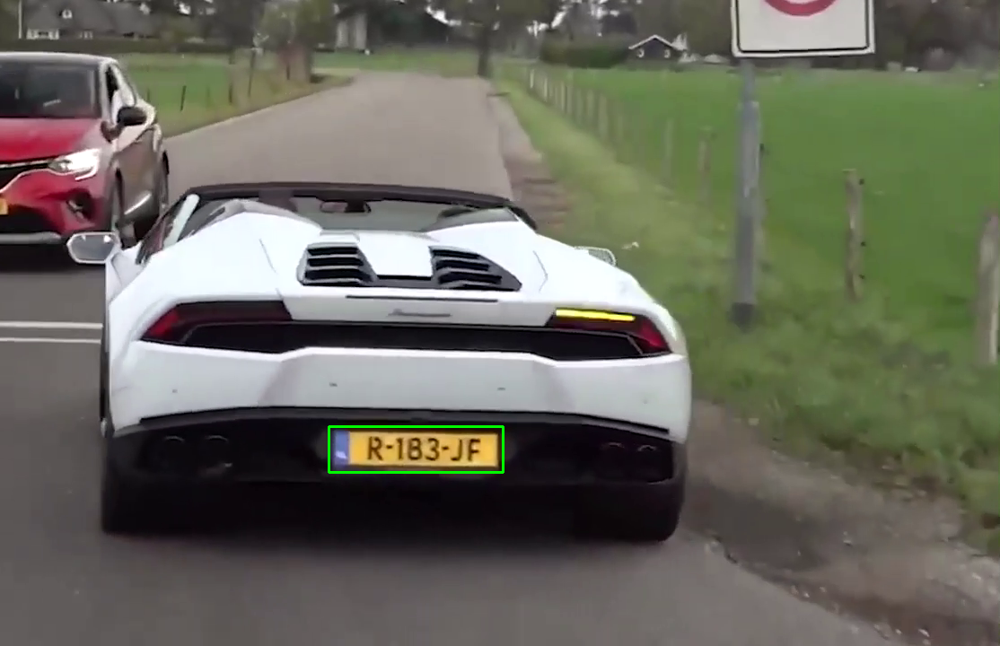


0: 416x640 2 cars, 12.9ms
Speed: 2.3ms preprocess, 12.9ms inference, 1.7ms postprocess per image at shape (1, 3, 416, 640)

0: 416x640 1 plaque, 12.0ms
Speed: 3.2ms preprocess, 12.0ms inference, 1.2ms postprocess per image at shape (1, 3, 416, 640)


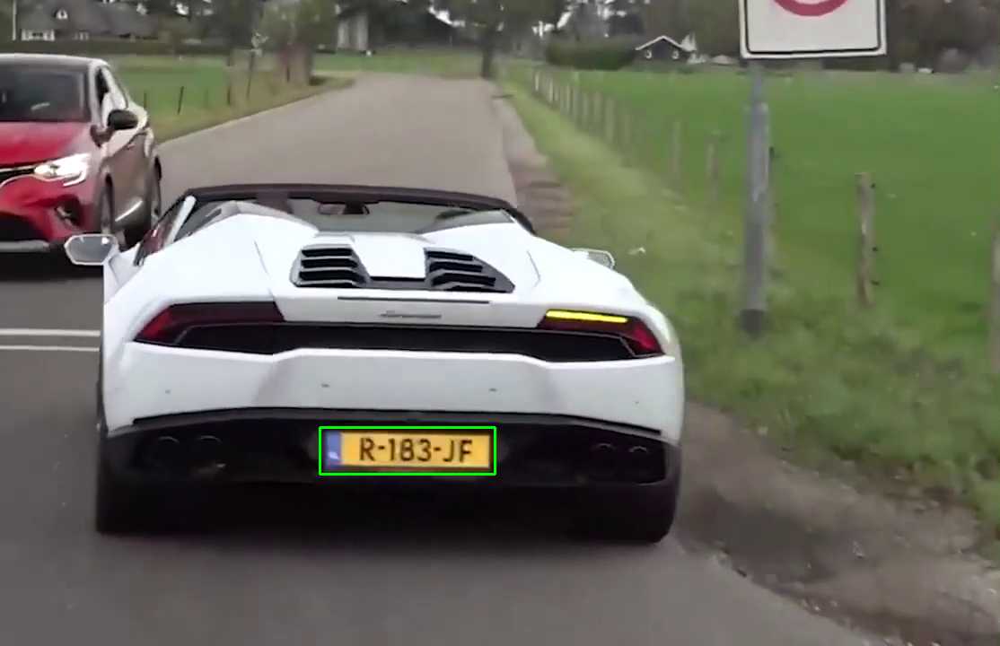


0: 416x640 2 cars, 12.9ms
Speed: 3.3ms preprocess, 12.9ms inference, 1.4ms postprocess per image at shape (1, 3, 416, 640)

0: 416x640 1 plaque, 11.9ms
Speed: 2.1ms preprocess, 11.9ms inference, 1.2ms postprocess per image at shape (1, 3, 416, 640)


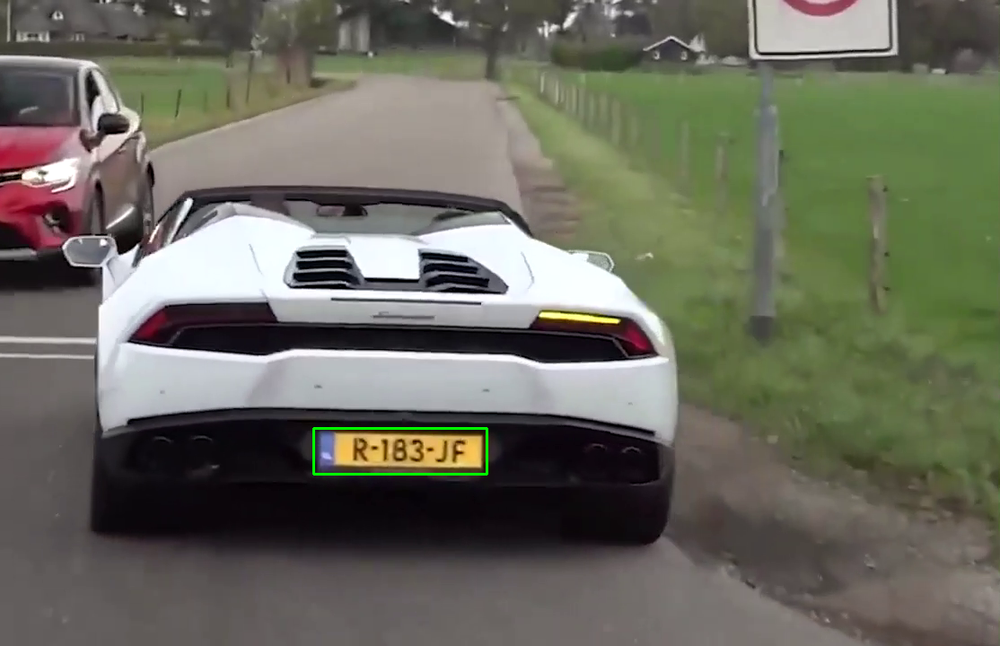


0: 416x640 2 cars, 12.9ms
Speed: 2.1ms preprocess, 12.9ms inference, 1.4ms postprocess per image at shape (1, 3, 416, 640)

0: 416x640 1 plaque, 11.9ms
Speed: 2.2ms preprocess, 11.9ms inference, 1.2ms postprocess per image at shape (1, 3, 416, 640)


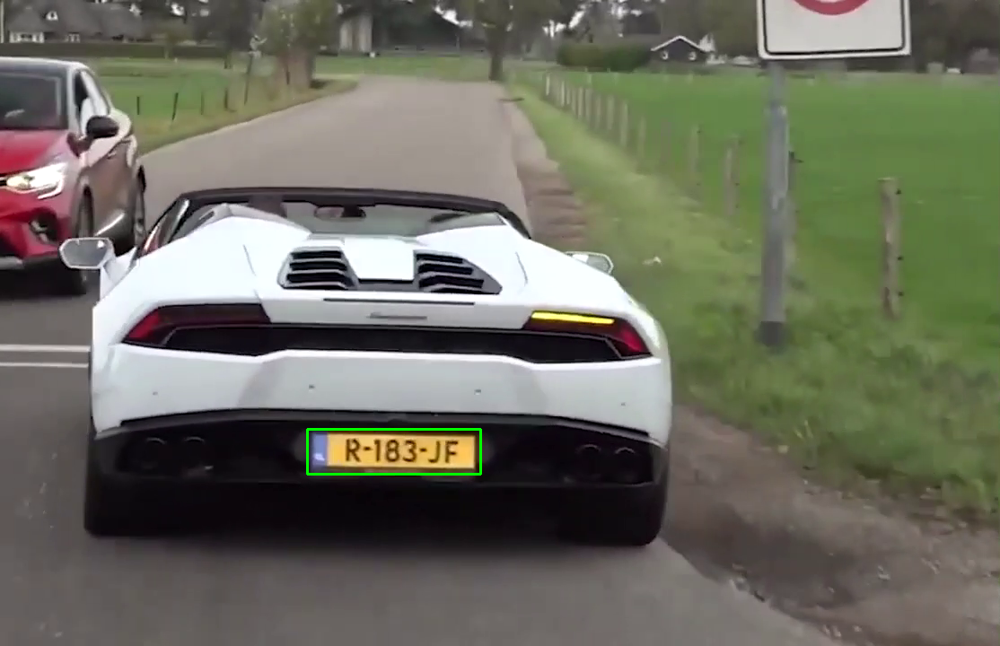


0: 416x640 2 cars, 1 truck, 12.9ms
Speed: 2.1ms preprocess, 12.9ms inference, 1.4ms postprocess per image at shape (1, 3, 416, 640)

0: 416x640 1 plaque, 11.9ms
Speed: 2.2ms preprocess, 11.9ms inference, 1.4ms postprocess per image at shape (1, 3, 416, 640)


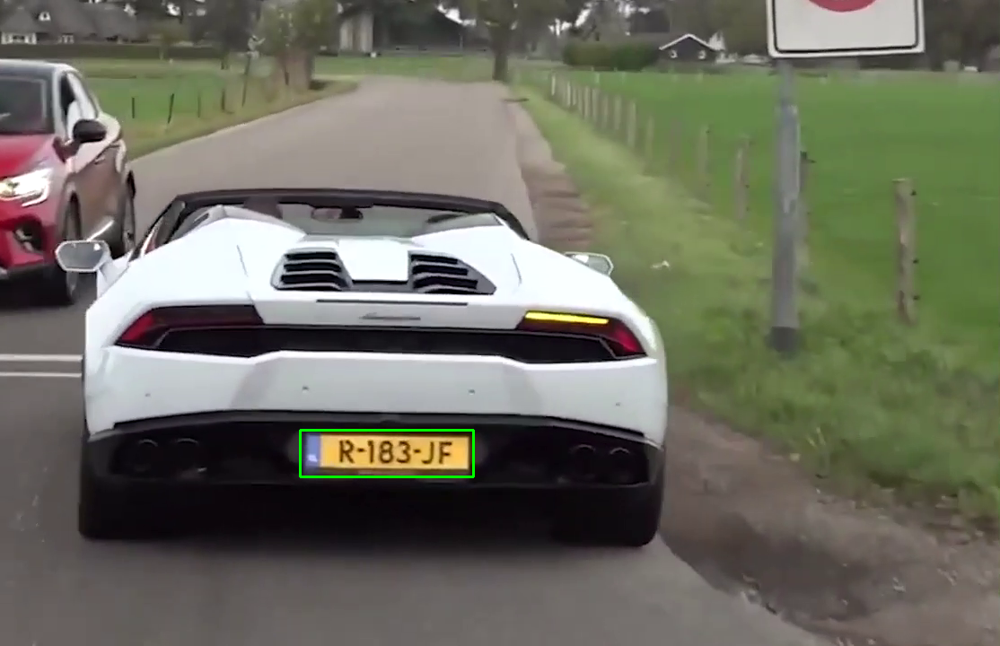


0: 416x640 2 cars, 1 truck, 12.9ms
Speed: 2.1ms preprocess, 12.9ms inference, 1.6ms postprocess per image at shape (1, 3, 416, 640)

0: 416x640 1 plaque, 11.9ms
Speed: 2.3ms preprocess, 11.9ms inference, 1.2ms postprocess per image at shape (1, 3, 416, 640)


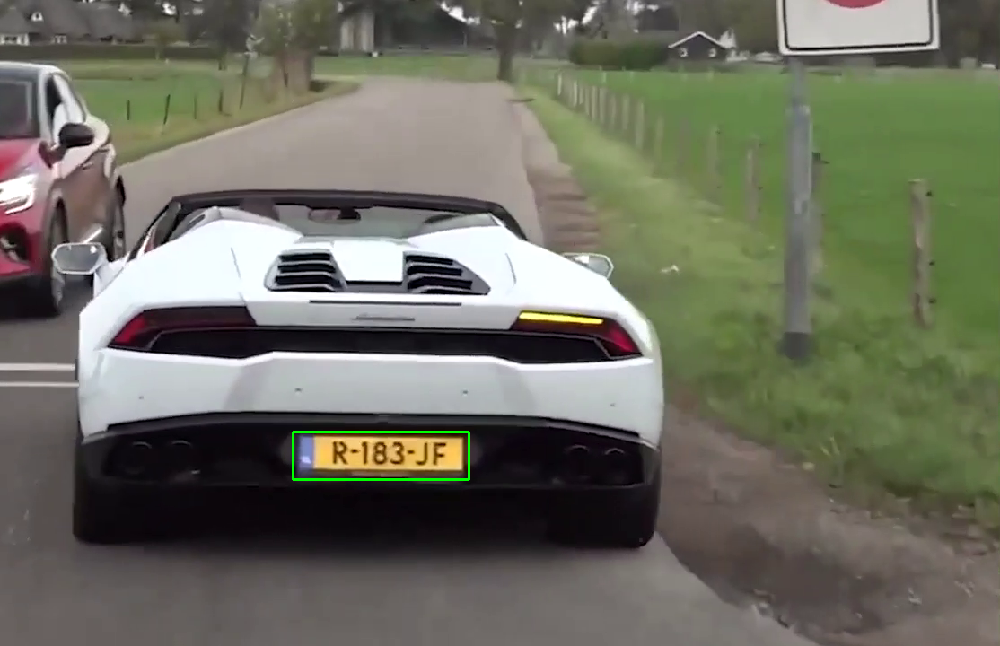


0: 416x640 2 cars, 12.9ms
Speed: 2.1ms preprocess, 12.9ms inference, 1.3ms postprocess per image at shape (1, 3, 416, 640)

0: 416x640 1 plaque, 11.9ms
Speed: 2.2ms preprocess, 11.9ms inference, 1.1ms postprocess per image at shape (1, 3, 416, 640)


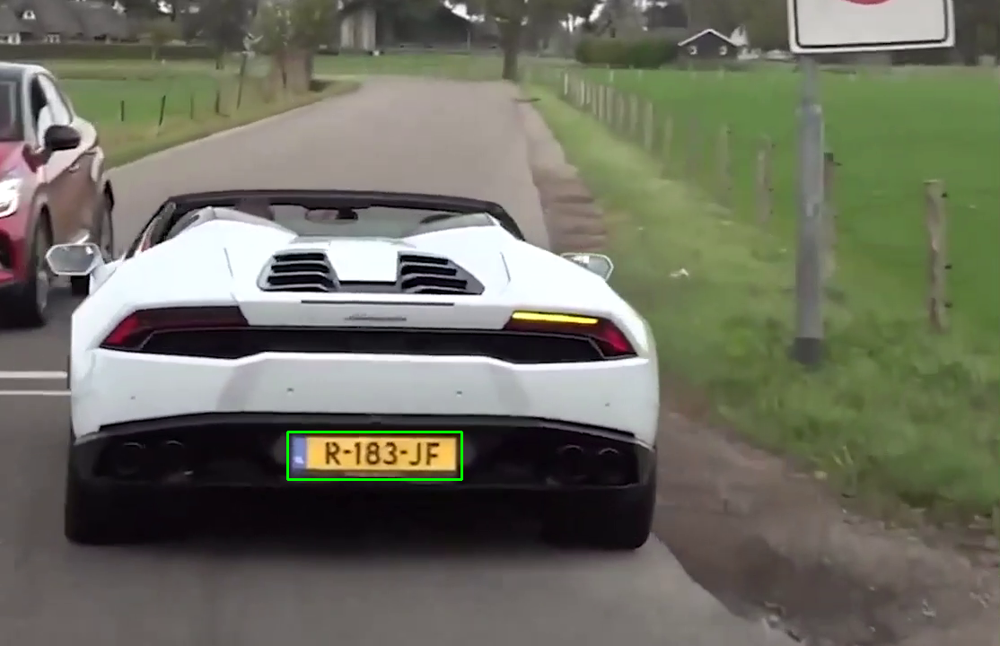


0: 416x640 2 cars, 12.9ms
Speed: 2.1ms preprocess, 12.9ms inference, 1.4ms postprocess per image at shape (1, 3, 416, 640)

0: 416x640 1 plaque, 12.7ms
Speed: 2.5ms preprocess, 12.7ms inference, 1.6ms postprocess per image at shape (1, 3, 416, 640)


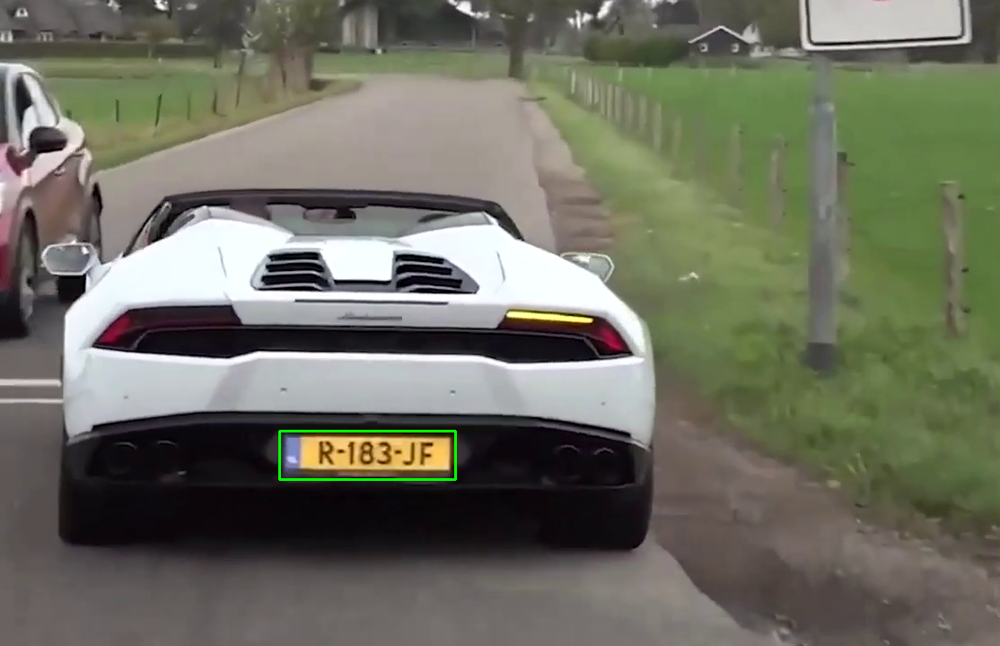


0: 416x640 2 cars, 12.9ms
Speed: 5.3ms preprocess, 12.9ms inference, 1.9ms postprocess per image at shape (1, 3, 416, 640)

0: 416x640 1 plaque, 13.8ms
Speed: 3.2ms preprocess, 13.8ms inference, 1.7ms postprocess per image at shape (1, 3, 416, 640)


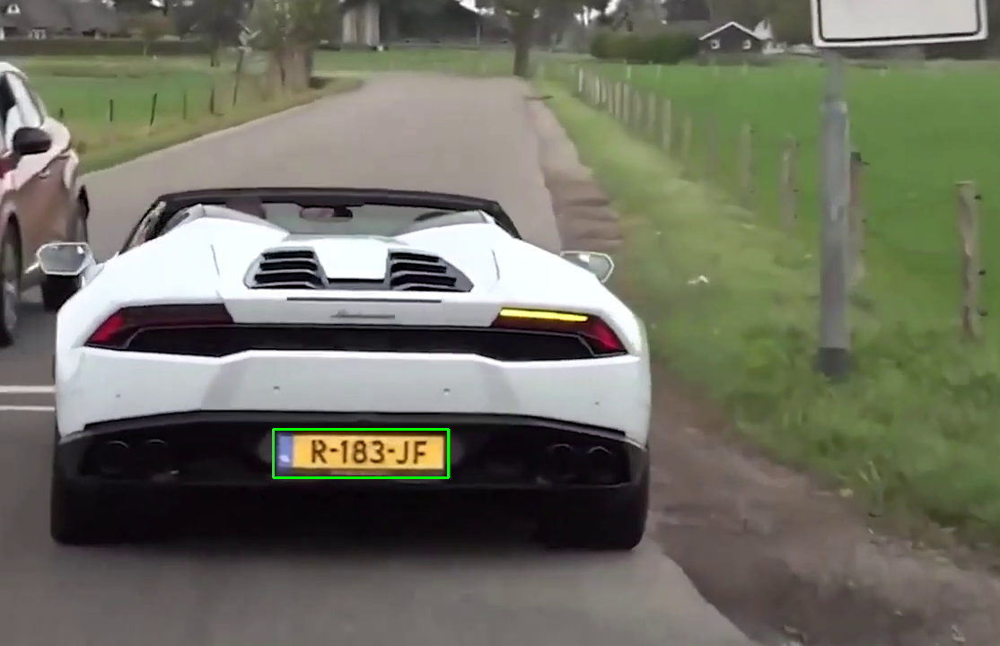


0: 416x640 2 cars, 12.9ms
Speed: 2.1ms preprocess, 12.9ms inference, 1.4ms postprocess per image at shape (1, 3, 416, 640)

0: 416x640 1 plaque, 11.9ms
Speed: 2.0ms preprocess, 11.9ms inference, 1.2ms postprocess per image at shape (1, 3, 416, 640)


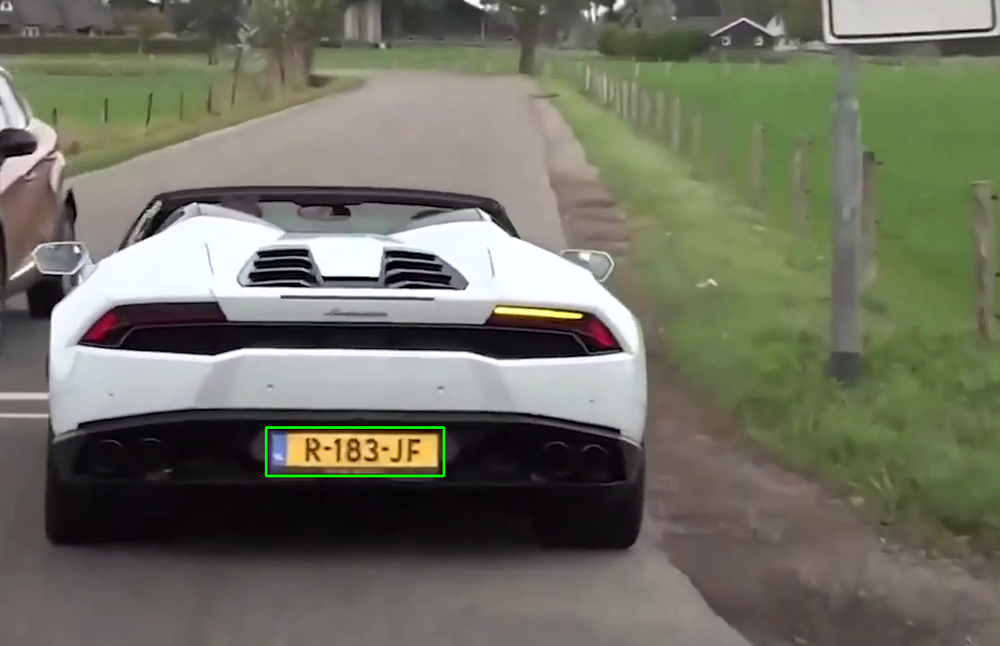


0: 416x640 2 cars, 12.9ms
Speed: 3.4ms preprocess, 12.9ms inference, 1.4ms postprocess per image at shape (1, 3, 416, 640)

0: 416x640 1 plaque, 11.9ms
Speed: 3.3ms preprocess, 11.9ms inference, 1.3ms postprocess per image at shape (1, 3, 416, 640)


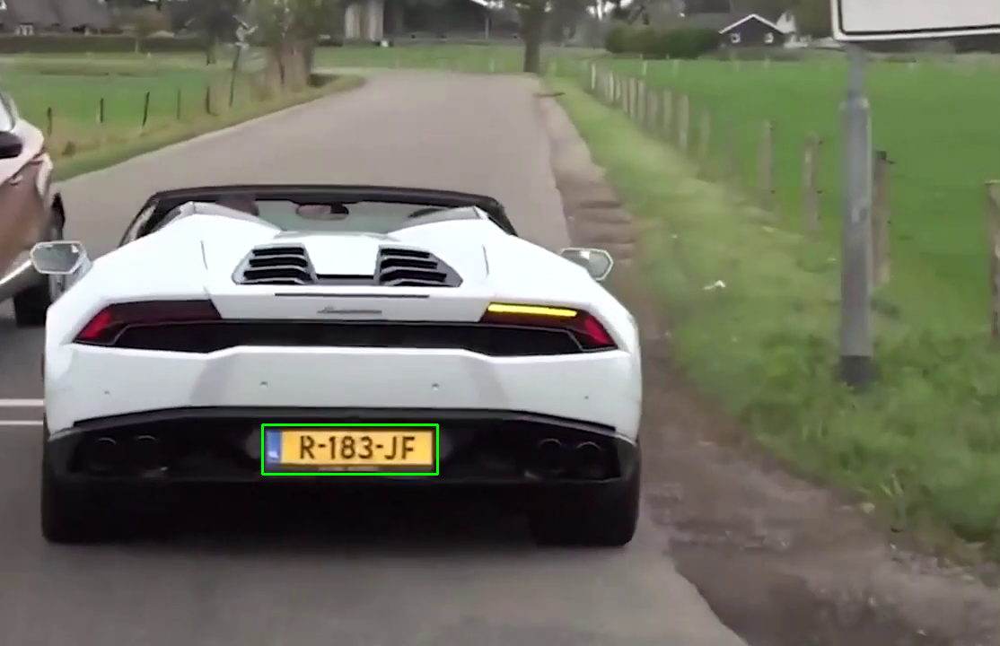


0: 416x640 1 person, 2 cars, 12.9ms
Speed: 2.3ms preprocess, 12.9ms inference, 1.4ms postprocess per image at shape (1, 3, 416, 640)

0: 416x640 1 plaque, 11.9ms
Speed: 2.0ms preprocess, 11.9ms inference, 1.2ms postprocess per image at shape (1, 3, 416, 640)


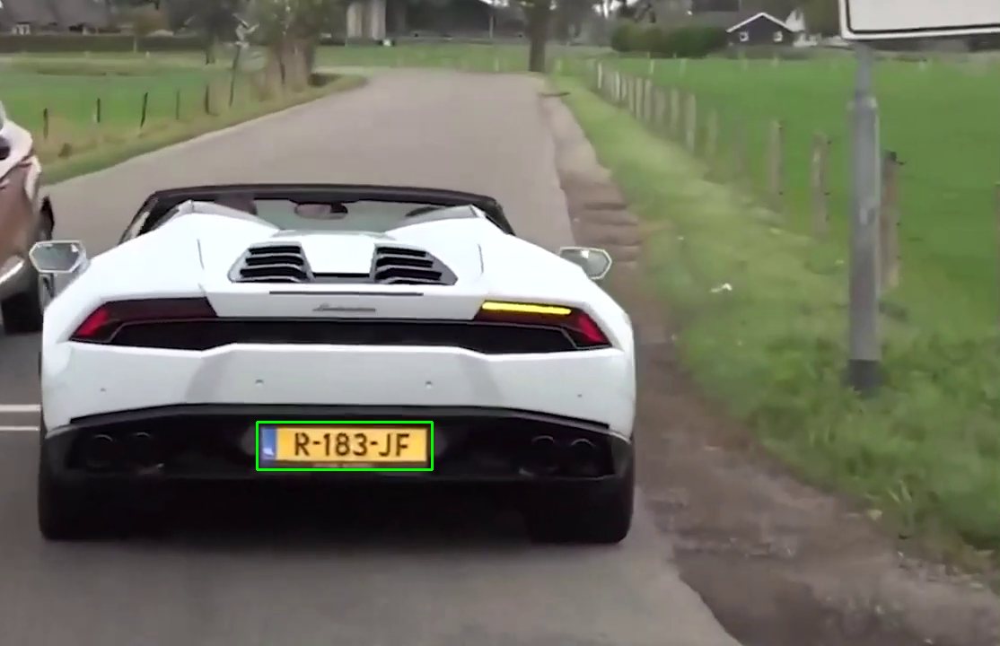

Traitement terminé. Résultats sauvegardés dans /content/drive/MyDrive/results.csv


In [22]:
# Importer les bibliothèques nécessaires
from ultralytics import YOLO
import supervision as sv
import cv2
import numpy as np
import os
from collections import deque
from google.colab.patches import cv2_imshow
from filterpy.kalman import KalmanFilter
import easyocr
import csv
from scipy.optimize import linear_sum_assignment

# Configurer EasyOCR
reader = easyocr.Reader(['en'], gpu=True)

# Définir les fonctions utilitaires
def write_csv(results: dict, output_path: str) -> None:
    """Sauvegarder les résultats dans un fichier CSV, en ignorant les entrées incomplètes."""
    with open(output_path, 'w', newline='') as csvfile:
        writer = csv.writer(csvfile)
        writer.writerow(['frame_number', 'car_id', 'car_bbox', 'license_plate_bbox',
                         'license_plate_conf_score', 'license_text',
                         'license_plate_text_conf_score'])

        for frame_number, car_id_dict in results.items():
            for car_id, data in car_id_dict.items():
                # Ignorer si 'car' ou 'license_plate' est manquant ou None
                if not data.get('car') or not data.get('license_plate'):
                    continue  # Passer à l'entrée suivante

                car_bbox = data['car']['bbox']
                license_plate = data['license_plate']

                # Vérifier les clés pour la plaque
                license_plate_bbox = license_plate.get('bbox', '')
                license_plate_conf_score = license_plate.get('license_plate_conf_score', 0.0)
                license_text = license_plate.get('license_text', '')
                license_plate_text_conf_score = license_plate.get('license_plate_text_conf_score', 0.0)

                # Écrire les données valides dans le CSV
                writer.writerow([frame_number, car_id, car_bbox, license_plate_bbox,
                                 license_plate_conf_score, license_text,
                                 license_plate_text_conf_score])


def read_license_plate(license_plate_cropped_img):
    """Lire le texte d'une plaque d'immatriculation à l'aide d'EasyOCR."""
    detections = reader.readtext(license_plate_cropped_img, text_threshold=0.8)
    if detections:
        # Extraire le texte et le score de la première détection
        return detections[0][1], detections[0][2]
    return '', 0.0


# Configurer les répertoires de sortie
output_dir = '/content/drive/MyDrive/imagessss'
os.makedirs(output_dir, exist_ok=True)


def main():
    """Fonction principale pour la détection et le suivi."""
    # Charger les modèles YOLO
    license_plate_detector = YOLO("/content/drive/MyDrive/YOLOv11Models/best.pt").to('cuda')
    coco_model = YOLO("/content/drive/MyDrive/models/yolov8s.pt").to('cuda')

    # Charger la vidéo
    cap = cv2.VideoCapture("/content/drive/MyDrive/videos/demo.mp4")
    if not cap.isOpened():
        print("Erreur : impossible d'ouvrir la vidéo.")
        return

    # Obtenir des informations sur la vidéo
    fps = int(cap.get(cv2.CAP_PROP_FPS))
    total_frames = int(cap.get(cv2.CAP_PROP_FRAME_COUNT))
    max_duration_seconds = 1  # Durée maximale à traiter (en secondes)
    max_frames_to_process = min(total_frames, fps * max_duration_seconds)

    print(f"Nombre total de frames : {total_frames}")
    print(f"FPS : {fps}")
    print(f"Frames à traiter : {max_frames_to_process}")

    frame_number = -1
    results = {}

    while frame_number < max_frames_to_process - 1:
        frame_number += 1
        ret, frame = cap.read()
        if not ret:
            print("Fin de la vidéo ou erreur de lecture.")
            break

        # Détection des objets
        detections = coco_model(frame)[0]
        detections = sv.Detections.from_ultralytics(detections)
        byte_tracker = sv.ByteTrack()
        tracks = byte_tracker.update_with_detections(detections)

        # Détection des plaques d'immatriculation
        license_plates = license_plate_detector(frame)

        for license_plate in license_plates[0].boxes.data.tolist():
         x1, y1, x2, y2, conf_score, cls_id = license_plate
         license_plate_crop = frame[int(y1):int(y2), int(x1):int(x2), :]
         cv2.imwrite(f'{output_dir}/frame_{frame_number}_plate_original.jpg', license_plate_crop)

    # Prétraitement et lecture OCR
         gray = cv2.cvtColor(license_plate_crop, cv2.COLOR_BGR2GRAY)
         _, binary = cv2.threshold(gray, 0, 255, cv2.THRESH_BINARY + cv2.THRESH_OTSU)
         license_plate_text, license_plate_text_conf_score = read_license_plate(binary)

    # Ajouter les résultats seulement si valides
         if int(cls_id) == 0:  # Classe voiture
           results.setdefault(frame_number, {})[cls_id] = {
            'car': {'bbox': f"{x1} {y1} {x2} {y2}"},
            'license_plate': {
                'bbox': f"{x1} {y1} {x2} {y2}",
                'license_plate_conf_score': conf_score,
                'license_text': license_plate_text,
                'license_plate_text_conf_score': license_plate_text_conf_score
            }
        }

        # Afficher les détections
        for license_plate in license_plates[0].boxes.data.tolist():
            x1, y1, x2, y2, conf_score, cls_id = license_plate
            cv2.rectangle(frame, (int(x1), int(y1)), (int(x2), int(y2)), (0, 255, 0), 2)
        cv2_imshow(frame)

    # Sauvegarder les résultats dans un fichier CSV
    write_csv(results, '/content/drive/MyDrive/results.csv')
    cap.release()
    print("Traitement terminé. Résultats sauvegardés dans /content/drive/MyDrive/results.csv")


# Exécuter le script principal
if __name__ == '__main__':
    main()


**NOTE:** Let's take a look at few results.

## Deploy model on Roboflow

Once you have finished training your YOLOv11 model, you’ll have a set of trained weights ready for use. These weights will be in the `/runs/detect/train/weights/best.pt` folder of your project. You can upload your model weights to Roboflow Deploy to use your trained weights on our infinitely scalable infrastructure.

The `.deploy()` function in the [Roboflow pip package](https://docs.roboflow.com/python) now supports uploading YOLOv11 weights.

In [ ]:
project.version(dataset.version).deploy(model_type="yolov11", model_path=f"{HOME}/runs/detect/train/")

In [ ]:
!pip install inference

In [ ]:
import os, random, cv2
import supervision as sv
import IPython
import inference

model_id = project.id.split("/")[1] + "/" + dataset.version
model = inference.get_model(model_id, userdata.get('ROBOFLOW_API_KEY'))

# Location of test set images
test_set_loc = dataset.location + "/test/images/"
test_images = os.listdir(test_set_loc)

# Run inference on 4 random test images, or fewer if fewer images are available
for img_name in random.sample(test_images, min(4, len(test_images))):
    print("Running inference on " + img_name)

    # Load image
    image = cv2.imread(os.path.join(test_set_loc, img_name))

    # Perform inference
    results = model.infer(image, confidence=0.4, overlap=30)[0]
    detections = sv.Detections.from_inference(results)

    # Annotate boxes and labels
    box_annotator = sv.BoxAnnotator()
    label_annotator = sv.LabelAnnotator()
    annotated_image = box_annotator.annotate(scene=image, detections=detections)
    annotated_image = label_annotator.annotate(scene=annotated_image, detections=detections)

    # Display annotated image
    _, ret = cv2.imencode('.jpg', annotated_image)
    i = IPython.display.Image(data=ret)
    IPython.display.display(i)


## 🏆 Congratulations

### Learning Resources

Roboflow has produced many resources that you may find interesting as you advance your knowledge of computer vision:

- [Roboflow Notebooks](https://github.com/roboflow/notebooks): A repository of over 20 notebooks that walk through how to train custom models with a range of model types, from YOLOv7 to SegFormer.
- [Roboflow YouTube](https://www.youtube.com/c/Roboflow): Our library of videos featuring deep dives into the latest in computer vision, detailed tutorials that accompany our notebooks, and more.
- [Roboflow Discuss](https://discuss.roboflow.com/): Have a question about how to do something on Roboflow? Ask your question on our discussion forum.
- [Roboflow Models](https://roboflow.com): Learn about state-of-the-art models and their performance. Find links and tutorials to guide your learning.

### Convert data formats

Roboflow provides free utilities to convert data between dozens of popular computer vision formats. Check out [Roboflow Formats](https://roboflow.com/formats) to find tutorials on how to convert data between formats in a few clicks.

### Connect computer vision to your project logic

[Roboflow Templates](https://roboflow.com/templates) is a public gallery of code snippets that you can use to connect computer vision to your project logic. Code snippets range from sending emails after inference to measuring object distance between detections.